# Import

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import hdbscan 
import umap
from sklearn.metrics import silhouette_score, adjusted_rand_score
from sklearn.preprocessing import StandardScaler
import seaborn as sns
import time
import utils
from itertools import product

In [2]:
import utils

# Data

In [3]:
%%time
# Read
raw = pd.read_csv('../data/online_shoppers_intention.zip')
print('size before drop na: ', len(raw))
raw = raw.dropna()
print('size after drop na: ', len(raw))
raw.reset_index(drop=True, inplace=True)
# raw = raw.sample(10000)
# raw.reset_index(drop=True, inplace=True)
raw.head()

size before drop na:  12330
size after drop na:  12316
Wall time: 42.3 ms


,Administrative,Administrative_Duration,Informational,Informational_Duration,ProductRelated,ProductRelated_Duration,BounceRates,ExitRates,PageValues,SpecialDay,Month,OperatingSystems,Browser,Region,TrafficType,VisitorType,Weekend,Revenue
0,0.0,0.0,0.0,0.0,1.0,0.000000,0.20,0.20,0.0,0.0,Feb,1,1,1,1,Returning_Visitor,False,False
1,0.0,0.0,0.0,0.0,2.0,64.000000,0.00,0.10,0.0,0.0,Feb,2,2,1,2,Returning_Visitor,False,False
2,0.0,-1.0,0.0,-1.0,1.0,-1.000000,0.20,0.20,0.0,0.0,Feb,4,1,9,3,Returning_Visitor,False,False
3,0.0,0.0,0.0,0.0,2.0,2.666667,0.05,0.14,0.0,0.0,Feb,3,2,2,4,Returning_Visitor,False,False
4,0.0,0.0,0.0,0.0,10.0,627.500000,0.02,0.05,0.0,0.0,Feb,3,3,1,4,Returning_Visitor,True,False


In [4]:
raw.shape

(12316, 18)

In [27]:
# Drop dupliates
print("size before drop duplicates: ", len(raw))
df = raw[features].drop_duplicates()
df.reset_index(inplace=True, drop=True)
print("size after drop duplicates: ", len(df))

size before drop duplicates:  12316
size after drop duplicates:  11565


In [28]:
df.head()

,Administrative,Administrative_Duration,BounceRates,ExitRates,Informational,Informational_Duration,PageValues,ProductRelated,ProductRelated_Duration,SpecialDay
0,0.0,0.0,0.20,0.20,0.0,0.0,0.0,1.0,0.000000,0.0
1,0.0,0.0,0.00,0.10,0.0,0.0,0.0,2.0,64.000000,0.0
2,0.0,-1.0,0.20,0.20,0.0,-1.0,0.0,1.0,-1.000000,0.0
3,0.0,0.0,0.05,0.14,0.0,0.0,0.0,2.0,2.666667,0.0
4,0.0,0.0,0.02,0.05,0.0,0.0,0.0,10.0,627.500000,0.0


# Wrapper

In [5]:
import importlib
importlib.reload(utils)

<module 'utils' from 'C:\\Users\\Kevin Go\\Desktop\\tm\\prediction_team\\blog_umap_hdbscan\\notebooks\\utils.py'>

## Round 1

In [19]:
# Variables
RANDOM_SEED = 1
MIN_CLUSTER_SIZE = 100
MIN_SAMPLES = MIN_CLUSTER_SIZE

# Hyperparams
hypers_hdbscan = {
    "prediction_data": True,
    "min_cluster_size": MIN_CLUSTER_SIZE,
    "min_samples": MIN_SAMPLES
}

# Features
features = [
    'Administrative',
    'Administrative_Duration',
    'Informational',
    'Informational_Duration',
    'ProductRelated',
    'ProductRelated_Duration',
    'BounceRates',
    'ExitRates',
    'PageValues',
    'SpecialDay'
]
features.sort()

Wall time: 13.9 s


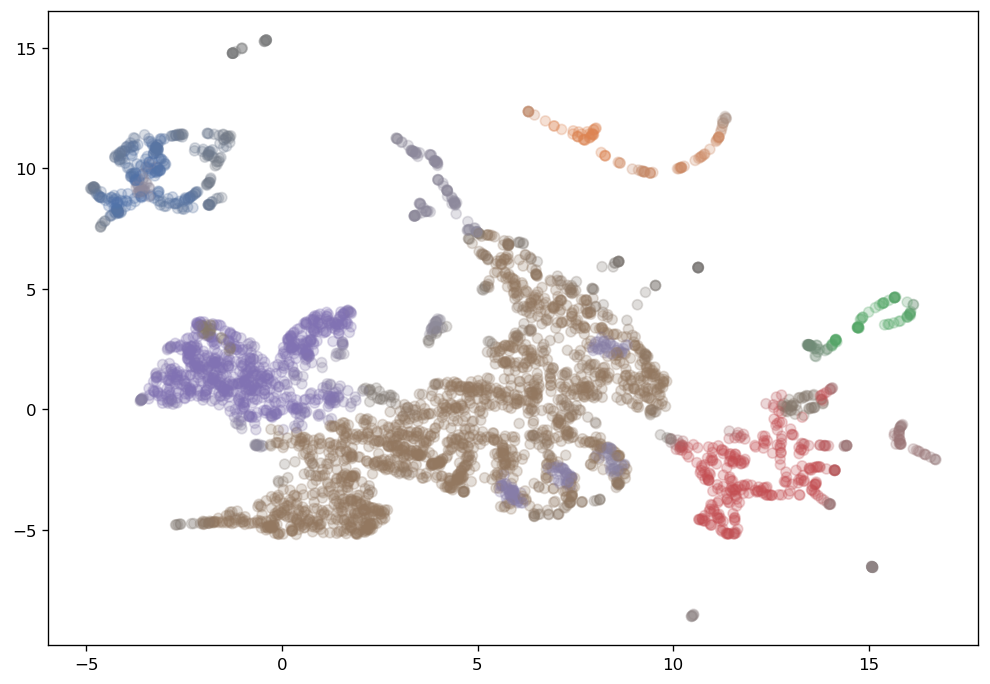

In [31]:
%%time
# Run
output1 = utils.clustering_wrapper(
    df,
    features,
    RANDOM_SEED,
    hypers_hdbscan,
    plot_sample_size = 4000
)

Wall time: 13.6 s


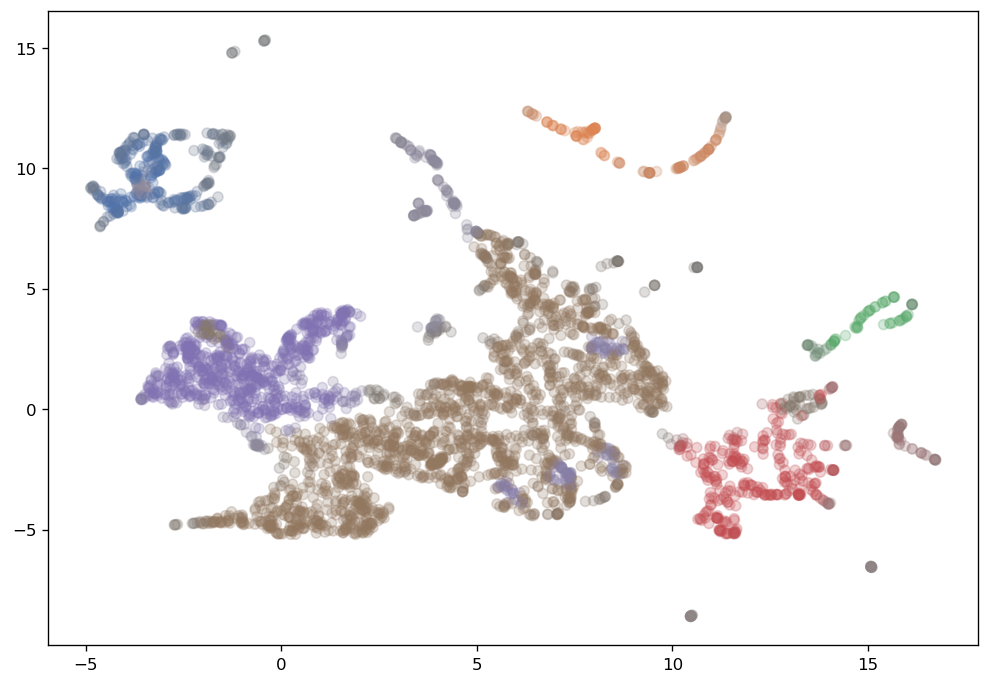

In [32]:
%%time
# Run
output2 = utils.clustering_wrapper(
    df,
    features,
    RANDOM_SEED,
    hypers_hdbscan,
    plot_sample_size = 4000
)

# Experiments

In [37]:
import importlib
importlib.reload(utils)

<module 'utils' from 'C:\\Users\\Kevin Go\\Desktop\\tm\\prediction_team\\blog_umap_hdbscan\\notebooks\\utils.py'>

In [38]:
# Experiments to do
min_cluster_size = list(np.arange(50, 550, 50))
min_samples = list(np.arange(50,550,50))
random_seed = [1]
experiment_list = pd.DataFrame(product(min_cluster_size, min_samples, random_seed))
experiment_list.columns = ['min_cluster_size', 'min_samples', 'random_seed']
experiment_list.head()

,min_cluster_size,min_samples,random_seed
0,50,50,1
1,50,100,1
2,50,150,1
3,50,200,1
4,50,250,1


In [39]:
experiment_list.shape

(100, 3)

Experiment:  0
Experiment:  1
Experiment:  2
Experiment:  3
Experiment:  4
Experiment:  5
Experiment:  6
Experiment:  7
Experiment:  8
Experiment:  9
Experiment:  10
Experiment:  11
Experiment:  12
Experiment:  13
Experiment:  14
Experiment:  15
Experiment:  16
Experiment:  17
Experiment:  18
Experiment:  19
Experiment:  20


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  21


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  22


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  23


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  24


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  25


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  26


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  27


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  28


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  29


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  30


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  31


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  32


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  33


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  34


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  35


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  36


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  37


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  38


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  39


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  40


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  41


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  42


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  43


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  44


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  45


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  46


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  47


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  48


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  49


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  50


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  51


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  52


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  53


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  54


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  55


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  56


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  57


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  58


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  59


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  60


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  61


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  62


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  63


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  64


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  65


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  66


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  67


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  68


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  69


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  70


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  71


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  72


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  73


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  74


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  75


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  76


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  77


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  78


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  79


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  80


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  81


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  82


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  83


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  84


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  85


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  86


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  87


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  88


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  89


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  90


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  91


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  92


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  93


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  94


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  95


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  96


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  97


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  98


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Experiment:  99


C:\Users\Kevin Go\Desktop\tm\prediction_team\blog_umap_hdbscan\notebooks\utils.py:209: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


Wall time: 25min 56s


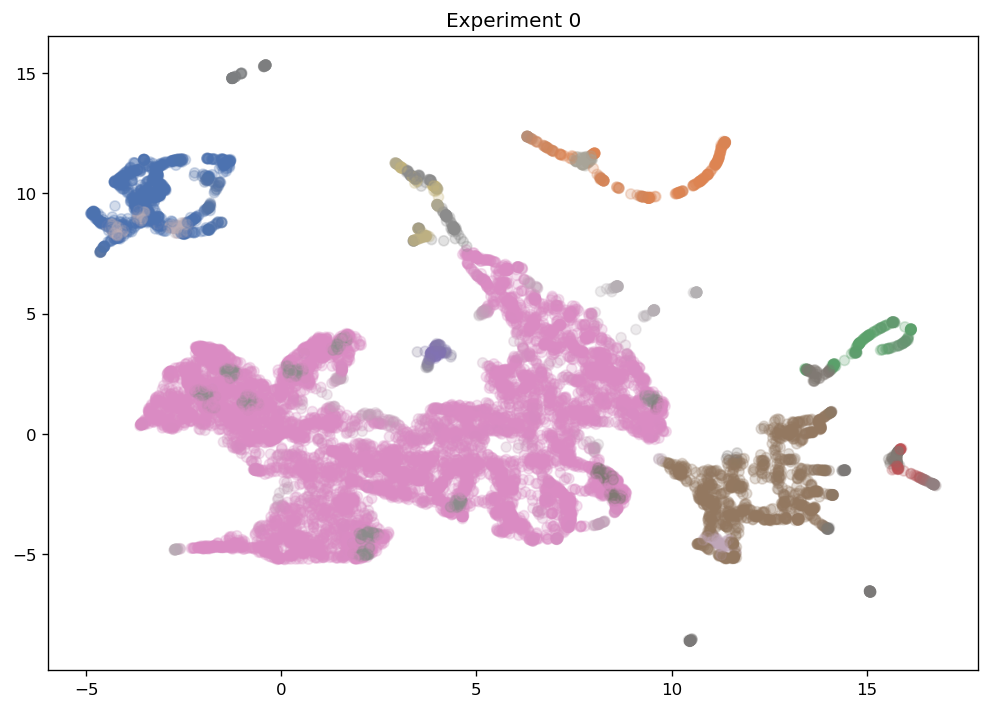

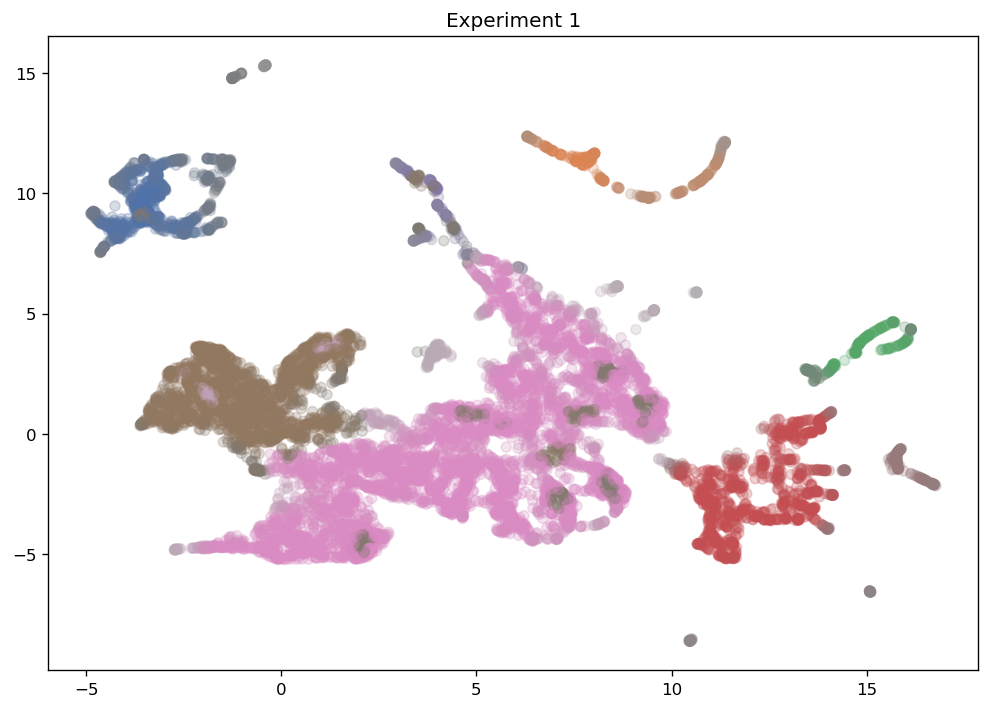

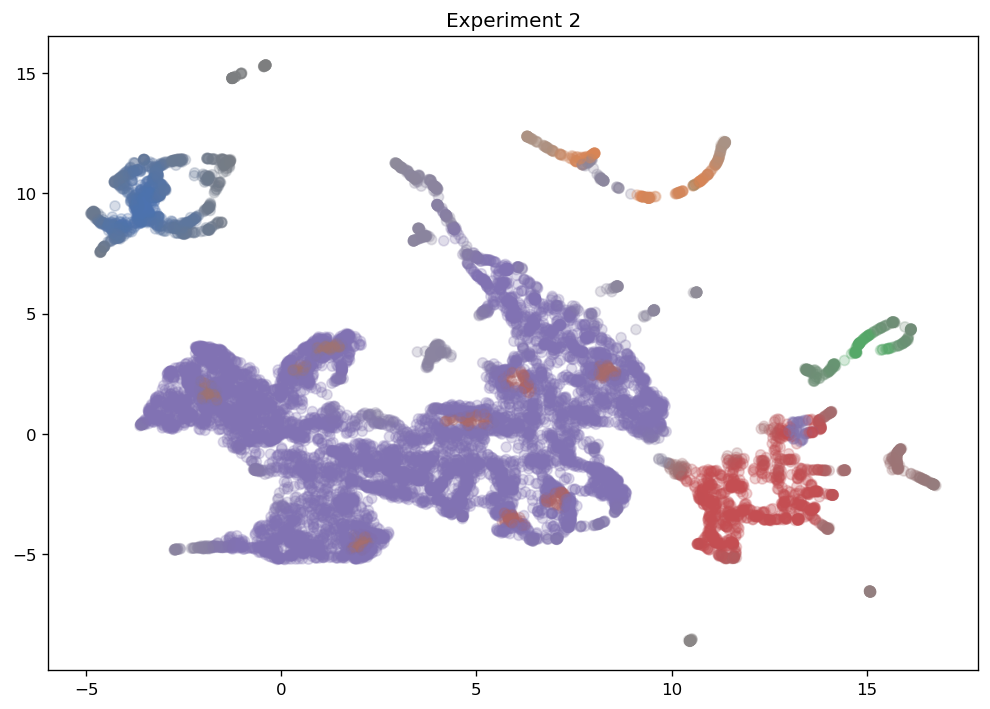

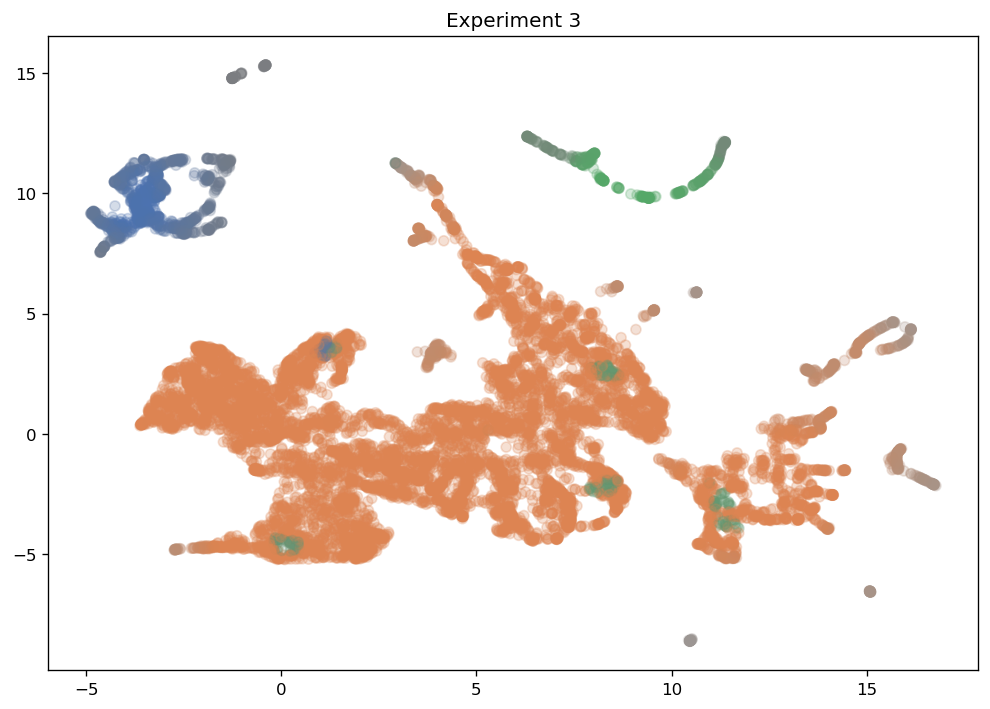

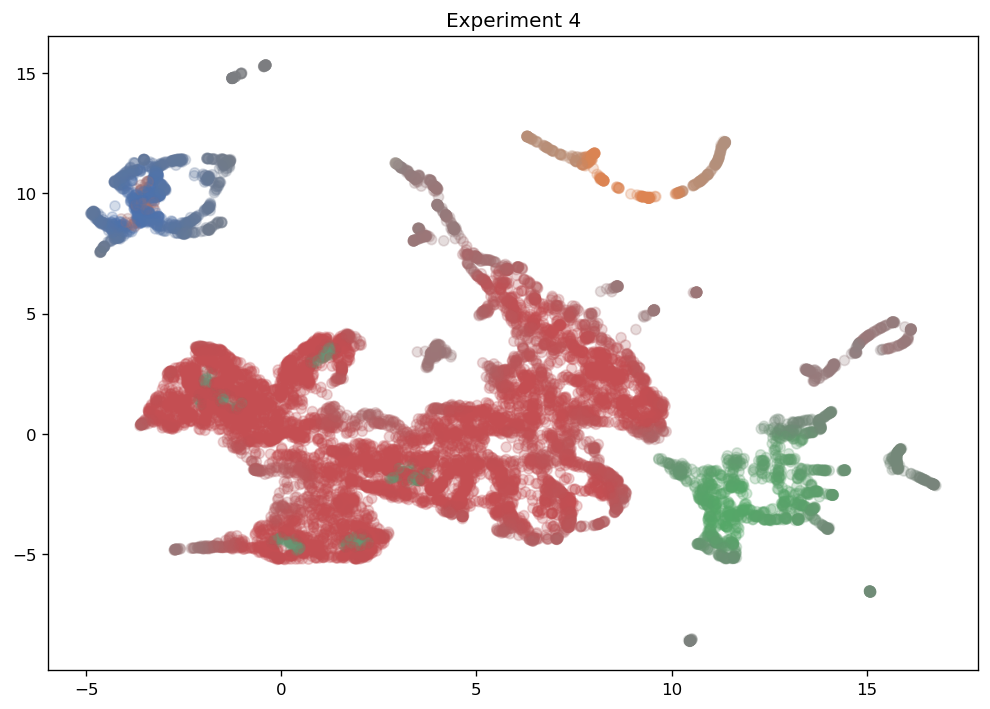

...

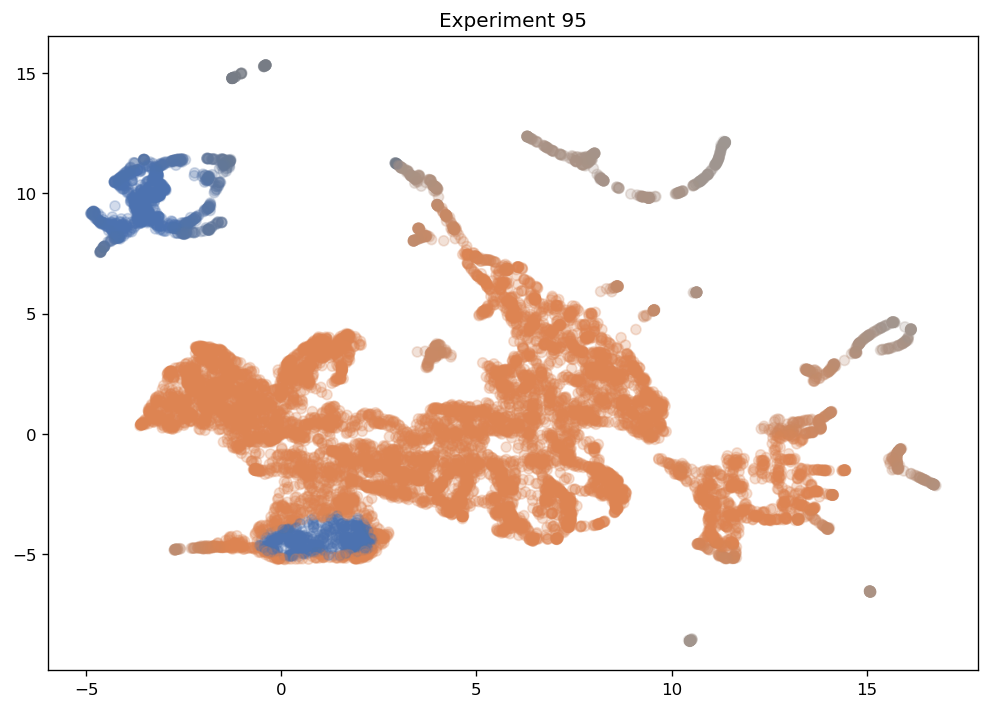

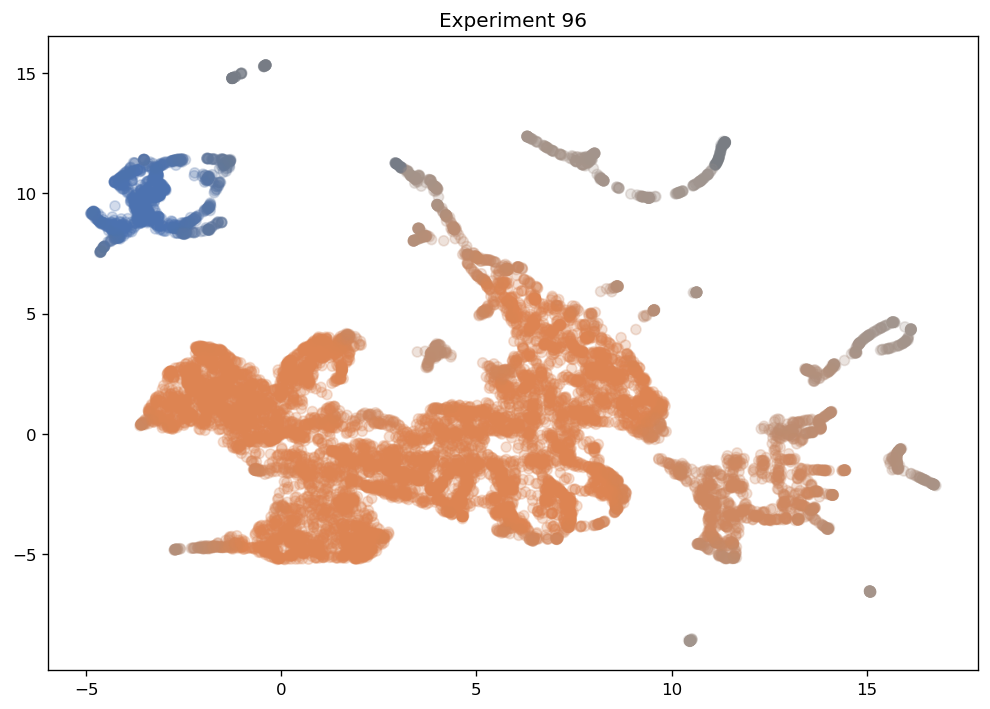

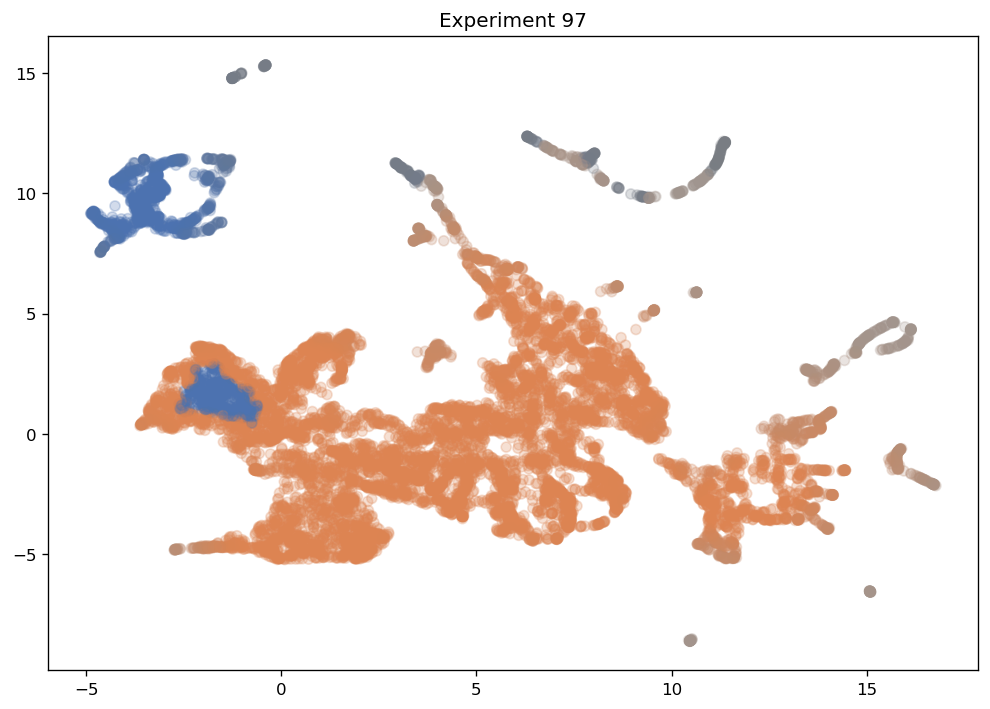

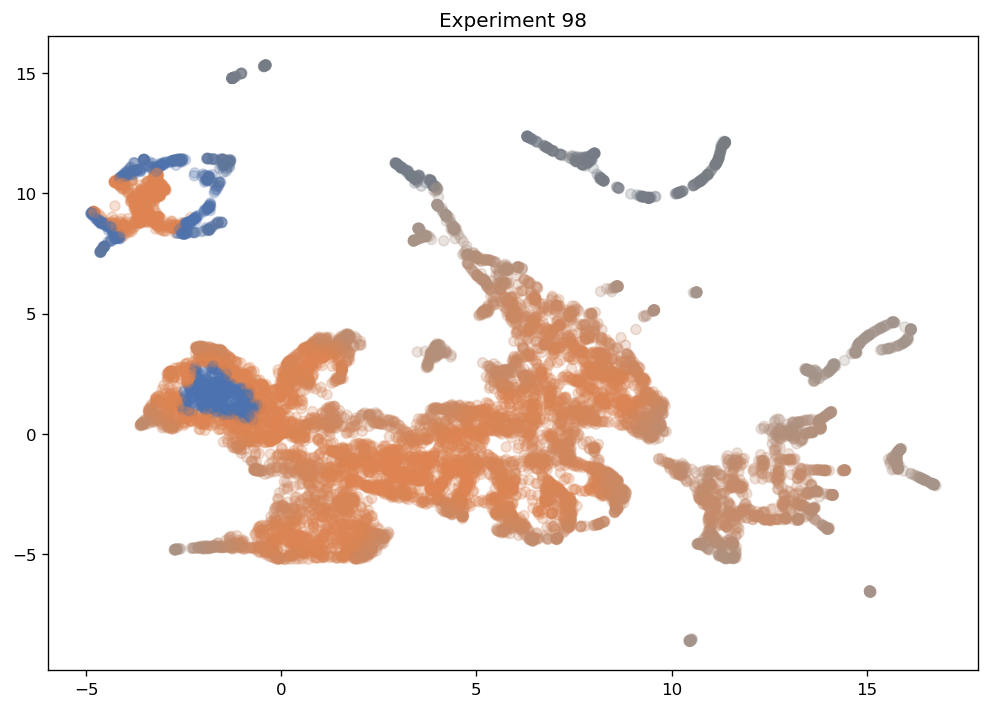

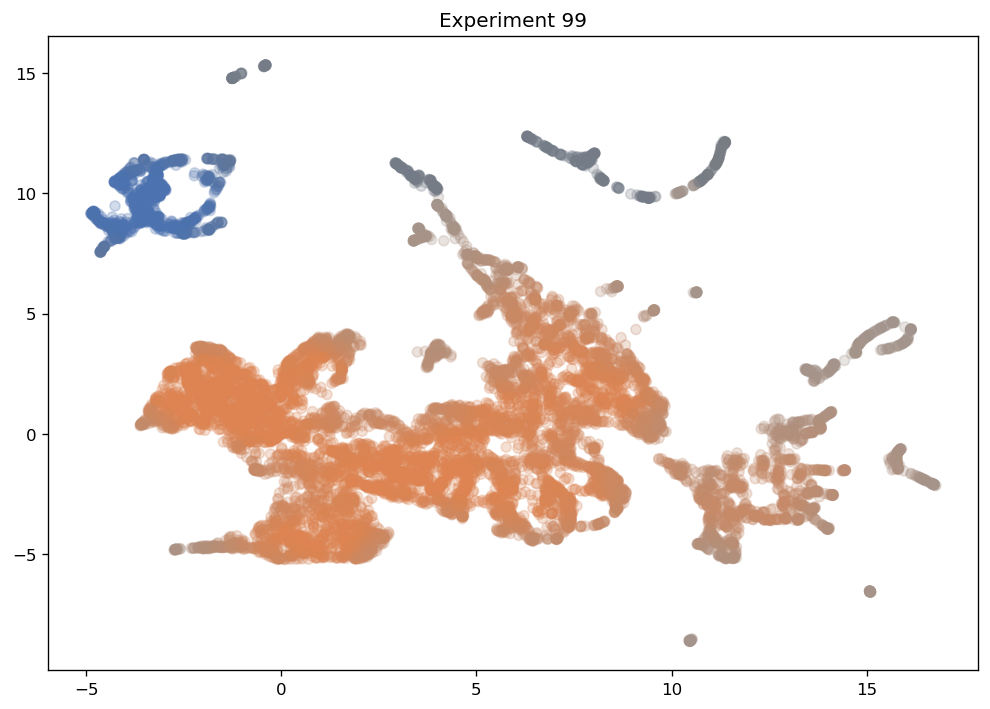

In [42]:
%%time

# Variables
RANDOM_SEED = 1
MIN_CLUSTER_SIZE = 250
MIN_SAMPLES = MIN_CLUSTER_SIZE

# Features
features = [
    'Administrative',
    'Administrative_Duration',
    'Informational',
    'Informational_Duration',
    'ProductRelated',
    'ProductRelated_Duration',
    'BounceRates',
    'ExitRates',
    'PageValues',
    'SpecialDay'
]
features.sort()

# Hyperparams
hypers_hdbscan = {
    "prediction_data": True,
    "min_cluster_size": MIN_CLUSTER_SIZE,
    "min_samples": MIN_SAMPLES
}

results = {}

# Run over n experiments
for i in range(len(experiment_list)):
    
    # HDBSCAN hyperparams
    hypers_hdbscan_i = {
        'min_cluster_size': int(experiment_list.loc[i,'min_cluster_size']),
        'min_samples': int(experiment_list.loc[i, 'min_samples'])
    }
    hypers_hdbscan.update(hypers_hdbscan_i)
    
#     # Other experiment settings
#     RANDOM_SEED = int(experiment_list.loc[i,'random_seed'])
    
    # Run
    print('Experiment: ', i)
    output = utils.clustering_wrapper(
        df,
        features,
        RANDOM_SEED,
        hypers_hdbscan,
        plot_sample_size = len(df),
        plot_title = 'Experiment {}'.format(i)
    )
    
    # Get metrics only
    output_metrics = output['metrics']
    output_metrics['runtime'] = output['runtime']
    output_metrics.update(hypers_hdbscan)
    output_metrics['random_seed'] = RANDOM_SEED
    
    # Save
    results[i] = output_metrics

In [43]:
# DF of results
results_df = pd.DataFrame(results).T
results_df

,n_clusters,percent_clustered,sil_score,pielou_evenness,runtime,prediction_data,min_cluster_size,min_samples,random_seed
0,9,100,-0.0162489,0.50209,13.7446,True,50,50,1
1,7,100,0.275534,0.70575,13.9252,True,50,100,1
2,5,100,0.248549,0.540145,14.2097,True,50,150,1
3,3,100,0.286126,0.442951,14.3837,True,50,200,1
4,4,100,0.274584,0.558974,14.9366,True,50,250,1
...,...,...,...,...,...,...,...,...,...
95,2,100,0.313883,0.568375,15.9421,True,500,300,1
96,2,100,0.435341,0.459189,15.958,True,500,350,1
97,2,100,0.356416,0.615491,16.1309,True,500,400,1
98,2,100,0.27417,0.539026,16.7765,True,500,450,1


In [46]:
results_df.sort_values('sil_score', ascending=False)

,n_clusters,percent_clustered,sil_score,pielou_evenness,runtime,prediction_data,min_cluster_size,min_samples,random_seed
99,2,100,0.447284,0.537312,17.5262,True,500,500,1
49,2,100,0.438829,0.493585,17.0652,True,250,500,1
57,2,100,0.435871,0.476217,17.0253,True,300,400,1
96,2,100,0.435341,0.459189,15.958,True,500,350,1
66,2,100,0.430454,0.435647,16.1859,True,350,350,1
...,...,...,...,...,...,...,...,...,...
41,3,100,0.0727594,0.503626,14.3413,True,250,100,1
30,4,100,0.035493,0.534693,14.5149,True,200,50,1
20,4,100,0.00117158,0.488634,14.2662,True,150,50,1
0,9,100,-0.0162489,0.50209,13.7446,True,50,50,1


In [49]:
results_df[results_df['n_clusters']==3].sort_values('sil_score', ascending=False)

,n_clusters,percent_clustered,sil_score,pielou_evenness,runtime,prediction_data,min_cluster_size,min_samples,random_seed
54,3,100,0.290814,0.620273,16.3558,True,300,250,1
3,3,100,0.286126,0.442951,14.3837,True,50,200,1
24,3,100,0.275016,0.623994,15.6802,True,150,250,1
44,3,100,0.256711,0.645308,15.4275,True,250,250,1
13,3,100,0.251156,0.451796,16.6723,True,100,200,1
34,3,100,0.246656,0.568847,15.0022,True,200,250,1
12,3,100,0.203258,0.493463,14.9573,True,100,150,1
64,3,100,0.191726,0.521587,15.6958,True,350,250,1
74,3,100,0.183968,0.646456,15.2666,True,400,250,1
94,3,100,0.177134,0.600436,15.1605,True,500,250,1


In [45]:
# results_df.to_csv('results_online_shoppers.csv')

# Look at one

In [60]:
# Variables
RANDOM_SEED = 1
MIN_CLUSTER_SIZE = 300
MIN_SAMPLES = 250

# Hyperparams
hypers_hdbscan = {
    "prediction_data": True,
    "min_cluster_size": MIN_CLUSTER_SIZE,
    "min_samples": MIN_SAMPLES
}

# Features
features = [
    'Administrative',
    'Administrative_Duration',
    'Informational',
    'Informational_Duration',
    'ProductRelated',
    'ProductRelated_Duration',
    'BounceRates',
    'ExitRates',
    'PageValues',
    'SpecialDay'
]
features.sort()

Wall time: 15.5 s


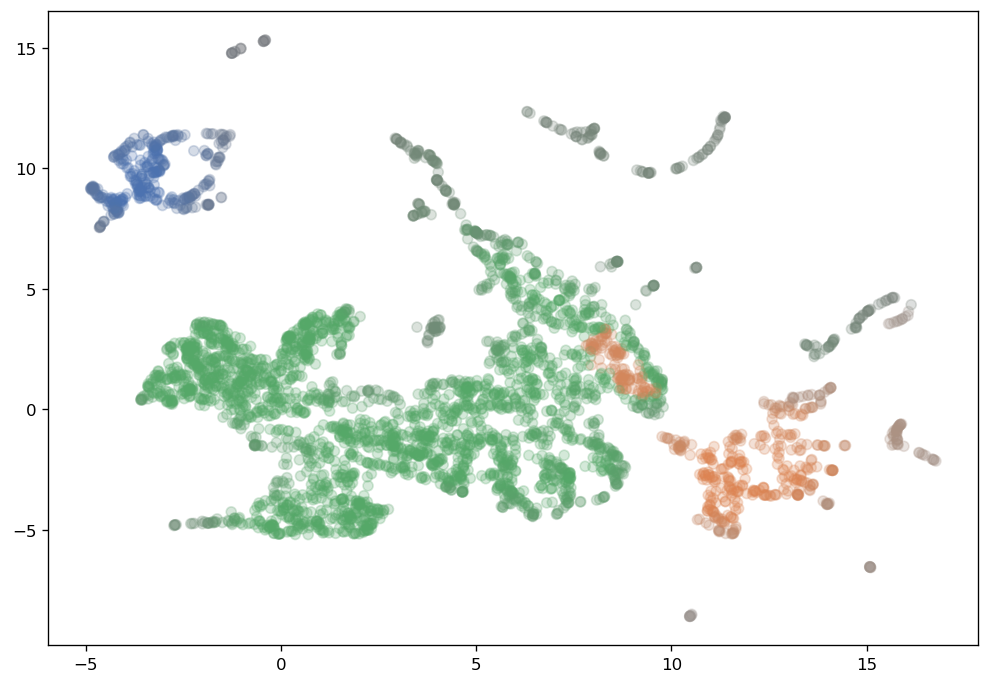

In [61]:
%%time
# Run
output = utils.clustering_wrapper(
    df,
    features,
    RANDOM_SEED,
    hypers_hdbscan,
    plot_sample_size = 4000
)

In [62]:
output.keys()

dict_keys(['scaler', 'reducer', 'clusterer', 'scores', 'colors', 'metrics', 'runtime'])

In [66]:
output_clusters = output['scores']['cluster'].unique()
output_clusters

array([0, 2, 1], dtype=int64)

In [67]:
# Colors
colors = utils.color_setter(len(output_clusters), output['scores'])
colors.keys()

dict_keys(['color_palette', 'cluster_colors', 'cluster_member_colors'])

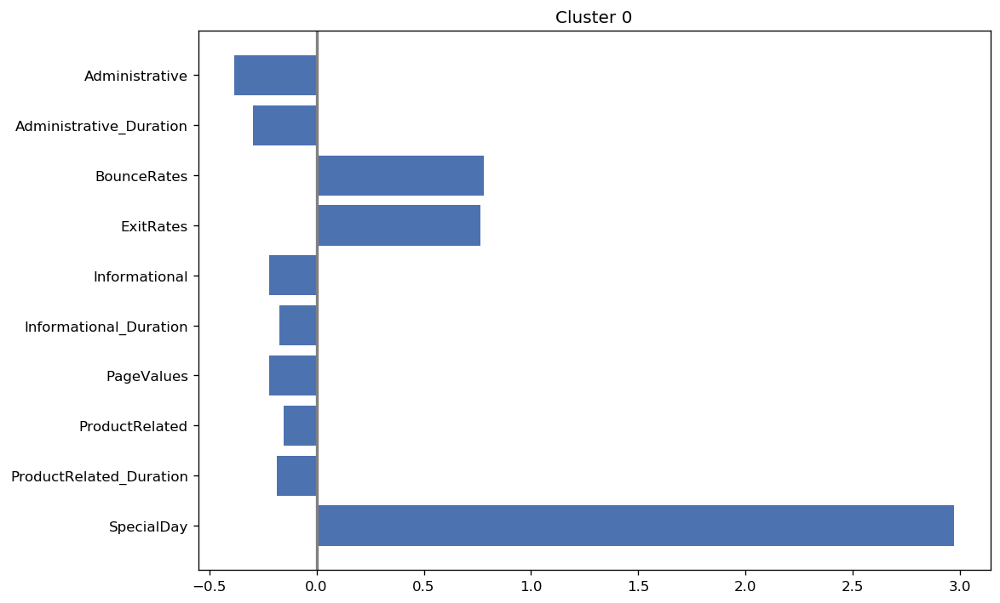

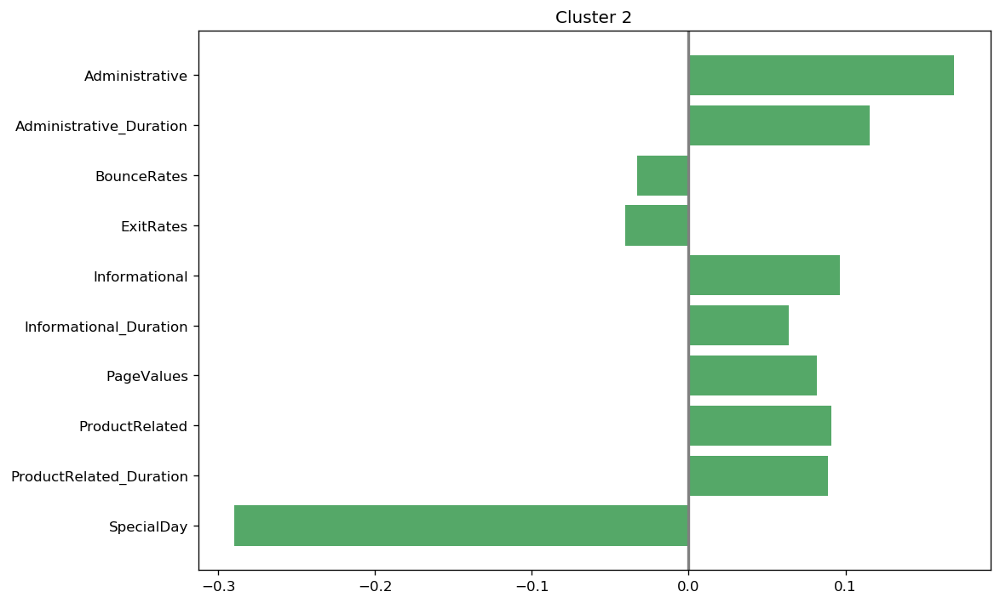

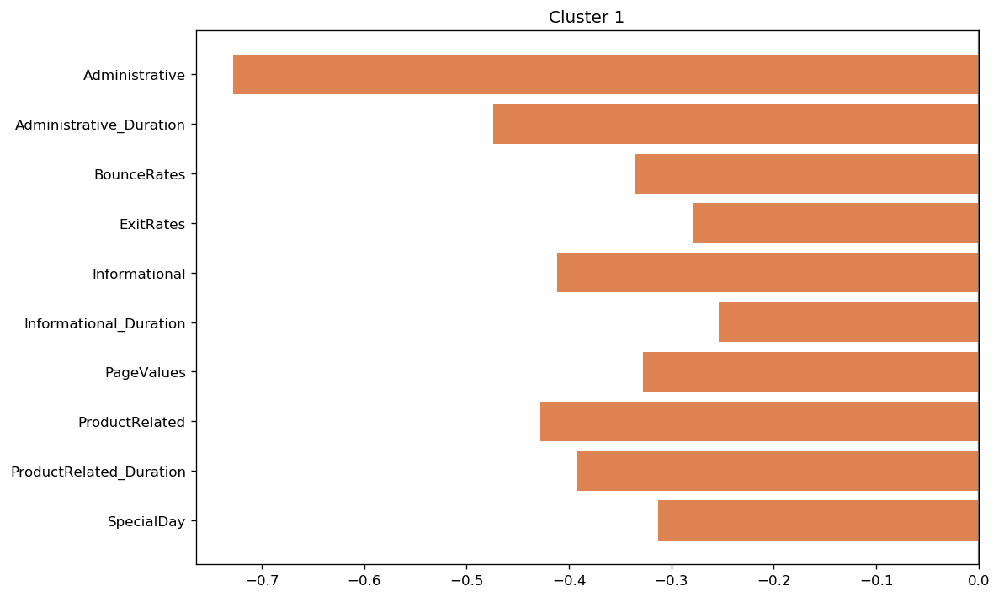

In [70]:
for i in output_clusters:
    utils.summary_plotter(output['scores'], features, colors['color_palette'], i)